In [1]:
import pandas as pd
from tsaug import Drift, AddNoise, TimeWarp
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import os
import sys
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import TimeSeriesSplit
import numpy as np
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.tsa.seasonal import STL


module_path = os.path.abspath(os.path.join(".."))
if module_path not in sys.path:
    sys.path.append(module_path)


from utils.constants import spectral_bands
from utils.calculate_indices import CalculateIndices

# Load
df_trees_raw = pd.read_csv("../../data/raw/raw_trainset.csv")

pd.set_option("display.max_columns", 500)

In [21]:
df_trees = df_trees_raw.sample(frac=0.4)
df_trees["time"] = pd.to_datetime(df_trees["time"])

In [22]:
from tsaug import Drift, AddNoise
import pandas as pd
import numpy as np
from scipy.interpolate import interp1d

df_trees_filter = df_trees[df_trees["species"]!="Norway_spruce"]
spurce = df_trees[df_trees["species"]=="Norway_spruce"]

def make_augmenter(series):
    scale = 0.002   # 0.2 % Rauschen
    drift = 0.01                    # 1 % Drift
    return Drift(max_drift=drift) + AddNoise(scale=scale)

augmented_dfs = []

max_len = len(spurce)

# Schleife über alle Baumarten
for species, df_species in df_trees_filter.groupby("species"):
    df_species["time"] = pd.to_datetime(df_species["time"])
    df_species = df_species.sort_values("time").reset_index(drop=True)

    species_len = len(df_species)
    scale_factor = round(max_len / species_len, 2)
    print(scale_factor, species)

    time = df_species["time"].reset_index(drop=True)
    
    # Neue Zeitachse abhängig vom Skalierungsfaktor
    time_aug = pd.date_range(
        start=time.min(),
        end=time.max(),
        periods=int(len(time) * scale_factor)
    )

    aug_data = {"species": species, "time": time_aug}

    # Schleife über alle b-Spalten
    for col in spectral_bands:
        if len(df_species[col].dropna()) < 5:
            continue
        Y = df_species[col].interpolate().to_numpy().astype(np.float64)

        augmenter = make_augmenter(df_species[col])
        Y_aug = augmenter.augment(Y)

        # Interpolation auf die neue Zeitachse
        
        f = interp1d(df_species["time"].view(np.int64), Y_aug, kind="linear", fill_value="extrapolate")
        Y_aug_resampled = f(time_aug.view(np.int64))


        # Sicherstellen, dass keine Werte <= 0 sind
        #Y_aug_resampled = np.where(Y_aug_resampled <= 0, 1e-6, Y_aug_resampled)

        aug_data[f"{col}"] = Y_aug_resampled

    # DataFrame für diese Art
    df_aug_species = pd.DataFrame(aug_data)
    augmented_dfs.append(df_aug_species)

# Alle augmentierten Daten kombinieren
df_aug_all = pd.concat(augmented_dfs, ignore_index=True)


0.55 Norway_spruce_mixed


/tmp/ipykernel_3140/1525534149.py:49: FutureWarning:

Series.view is deprecated and will be removed in a future version. Use ``astype`` as an alternative to change the dtype.

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning:

divide by zero encountered in divide

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:500: RuntimeWarning:

invalid value encountered in multiply



0.67 Scots_pine


/tmp/ipykernel_3140/1525534149.py:49: FutureWarning:

Series.view is deprecated and will be removed in a future version. Use ``astype`` as an alternative to change the dtype.

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning:

divide by zero encountered in divide

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:500: RuntimeWarning:

invalid value encountered in multiply



2.83 beech


/tmp/ipykernel_3140/1525534149.py:49: FutureWarning:

Series.view is deprecated and will be removed in a future version. Use ``astype`` as an alternative to change the dtype.

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning:

divide by zero encountered in divide

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:500: RuntimeWarning:

invalid value encountered in multiply



1.32 disturbed


/tmp/ipykernel_3140/1525534149.py:49: FutureWarning:

Series.view is deprecated and will be removed in a future version. Use ``astype`` as an alternative to change the dtype.

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning:

divide by zero encountered in divide

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:500: RuntimeWarning:

invalid value encountered in multiply



8.44 oak


/tmp/ipykernel_3140/1525534149.py:49: FutureWarning:

Series.view is deprecated and will be removed in a future version. Use ``astype`` as an alternative to change the dtype.

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning:

divide by zero encountered in divide

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:500: RuntimeWarning:

invalid value encountered in multiply



1.18 soil


/tmp/ipykernel_3140/1525534149.py:49: FutureWarning:

Series.view is deprecated and will be removed in a future version. Use ``astype`` as an alternative to change the dtype.

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:497: RuntimeWarning:

divide by zero encountered in divide

/home/alexandru/Dokumente/Studium/Semester 7/Domänenprojekt 2/tree_classification/.venv/lib/python3.12/site-packages/scipy/interpolate/_interpolate.py:500: RuntimeWarning:

invalid value encountered in multiply



In [23]:
df_trees = spurce.drop(columns=["id", "disturbance_year"])

In [24]:
df_aug_all = pd.concat([df_aug_all, df_trees])

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns

# Zeitspalte sicherstellen
df_trees["year"] = df_trees["time"].dt.year
df_aug_all["year"] = df_aug_all["time"].dt.year

def compare_species_year(species, year, band="b12"):
    """
    Vergleicht Original- und Augmentierte Werte einer Species und eines Jahres für ein Band.
    """
    # Filter Originaldaten
    df_orig = df_trees[
        (df_trees["species"] == species) & (df_trees["year"] == year)
    ].sort_values("time")

    # Filter Augmentierte Daten
    df_aug = df_aug_all[
        (df_aug_all["species"] == species) & (df_aug_all["year"] == year)
    ].sort_values("time")

    if df_orig.empty or df_aug.empty:
        print(f"⚠️ Keine Daten für {species} im Jahr {year}")
        return

    # Plot
    plt.figure(figsize=(10, 5))
    sns.lineplot(x="time", y=band, data=df_orig, label="Original", linewidth=2)
    sns.lineplot(x="time", y=f"{band}_aug", data=df_aug, label="Augmentiert", linewidth=2, linestyle="--")

    plt.title(f"{species} – {band} – Jahr {year}")
    plt.xlabel("Zeit")
    plt.ylabel("Wert")
    plt.legend()
    plt.tight_layout()
    plt.show()


ValueError: Could not interpret value `b2_aug` for `y`. An entry with this name does not appear in `data`.

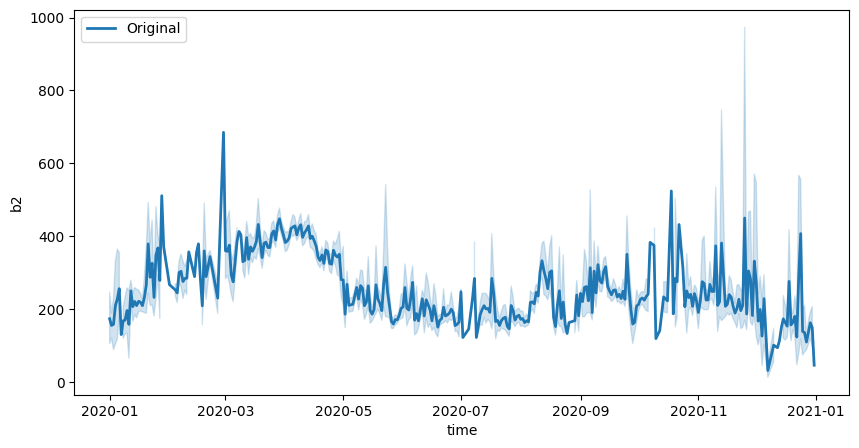

In [7]:
compare_species_year("oak", 2020, "b2")

In [25]:
px.pie(df_aug_all, names="species")

In [ ]:
spectral_bands.extend(["time", "species"])
pd.concat([df_aug_all, df_trees[spectral_bands]])